In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# OpenCV 활용

## 이미지 변환

- 이미지 읽기

- 이미지 컬러 변경

- 이미지 display

In [14]:
!pip list

Package                       Version
----------------------------- ----------------------
absl-py                       1.3.0
aeppl                         0.0.33
aesara                        2.7.9
aiohttp                       3.8.3
aiosignal                     1.3.1
alabaster                     0.7.12
albumentations                1.2.1
altair                        4.2.0
appdirs                       1.4.4
arviz                         0.12.1
astor                         0.8.1
astropy                       4.3.1
astunparse                    1.6.3
async-timeout                 4.0.2
asynctest                     0.13.0
atari-py                      0.2.9
atomicwrites                  1.4.1
attrs                         22.1.0
audioread                     3.0.0
autograd                      1.5
Babel                         2.11.0
backcall                      0.2.0
beautifulsoup4                4.6.3
bleach                        5.0.1
blis                          0.7.9
bokeh

In [15]:
# cv2 import
import cv2
from google.colab.patches import cv2_imshow

In [16]:
print("OpenCV version:")
print(cv2.__version__)

OpenCV version:
4.6.0


### 이미지 읽어오기


In [19]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [24]:
# GRAY 컬러로 변경
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

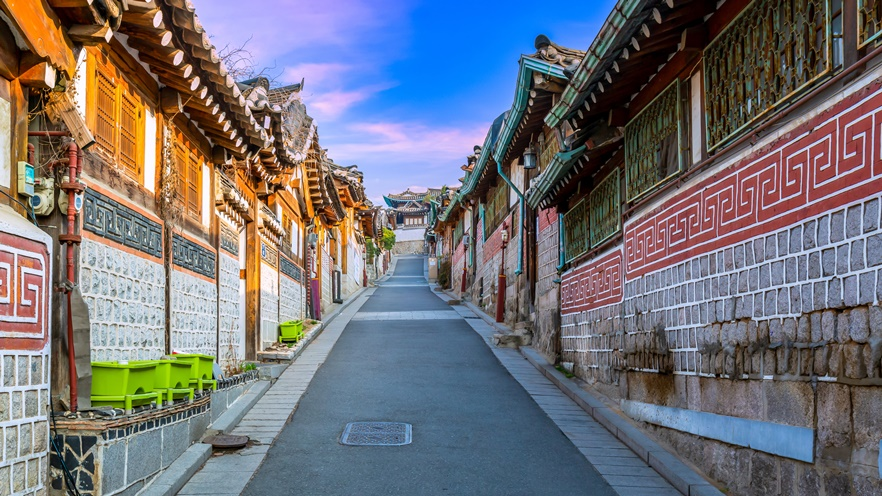

In [25]:
# 원본 이미지 Display
cv2_imshow(img)

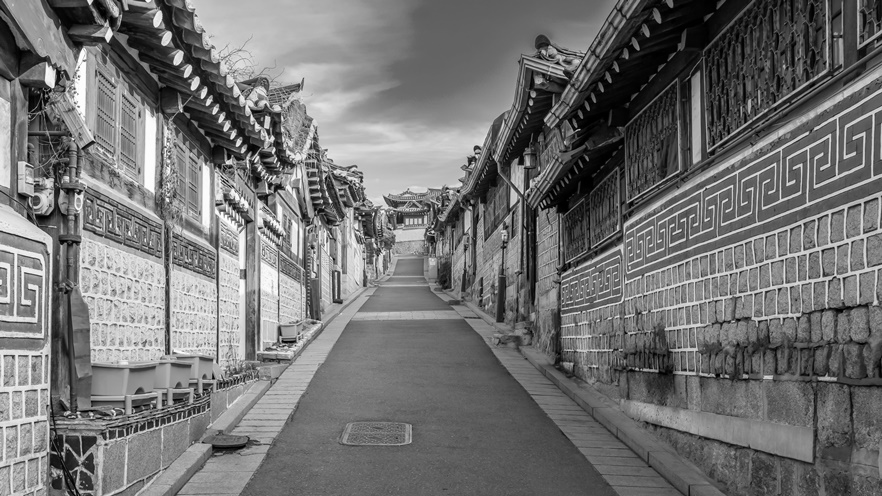

In [26]:
# 변경된 이미지 Display
cv2_imshow(gray)

## 이미지 복사

In [27]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [29]:
print(f'width: {img.shape[1]} pixels')
print(f'height: {img.shape[0]} pixels')
print(f'channels: {img.shape[2]}')

width: 882 pixels
height: 496 pixels
channels: 3


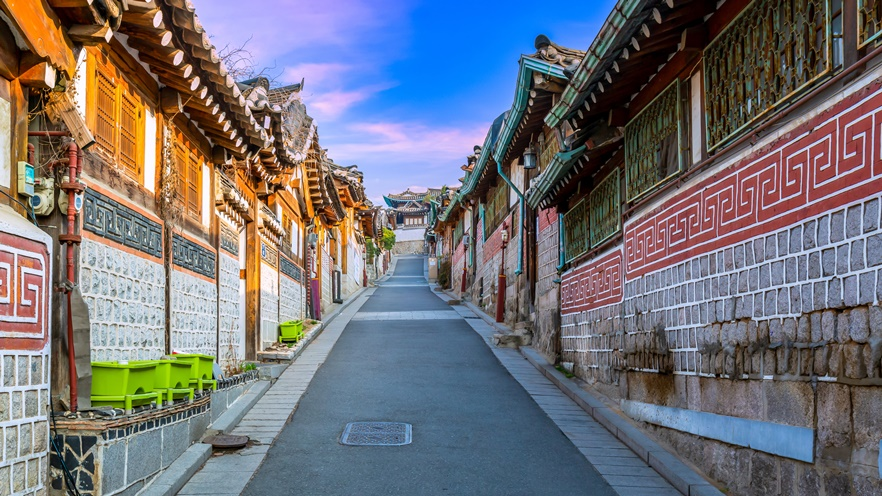

In [30]:
cv2_imshow(img)

In [31]:
cv2.imwrite('bukchon.jpg', img)

True

## Pixel, 해상도 이해

In [32]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [33]:
print(f'width: {img.shape[1]} pixels')
print(f'height: {img.shape[0]} pixels')
print(f'channels: {img.shape[2]}')

width: 882 pixels
height: 496 pixels
channels: 3


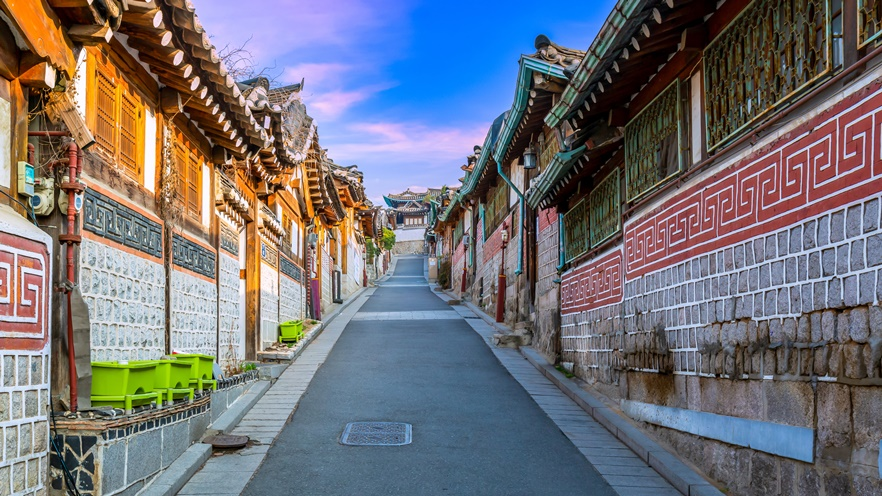

In [34]:
cv2_imshow(img)

### 특정 Pixel RGB 정보 확인

In [36]:
(b, g, r) = img[0, 0]
print(f'Pixel at (0, 0) - Red: {r}, Green: {g}, Blue: {b}')

Pixel at (0, 0) - Red: 63, Green: 40, Blue: 0


### 특정 영역 변환, 확인

In [41]:
img.shape

(496, 882, 3)

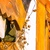

In [38]:
ROI = img[50:100, 50:100]
cv2_imshow(ROI)

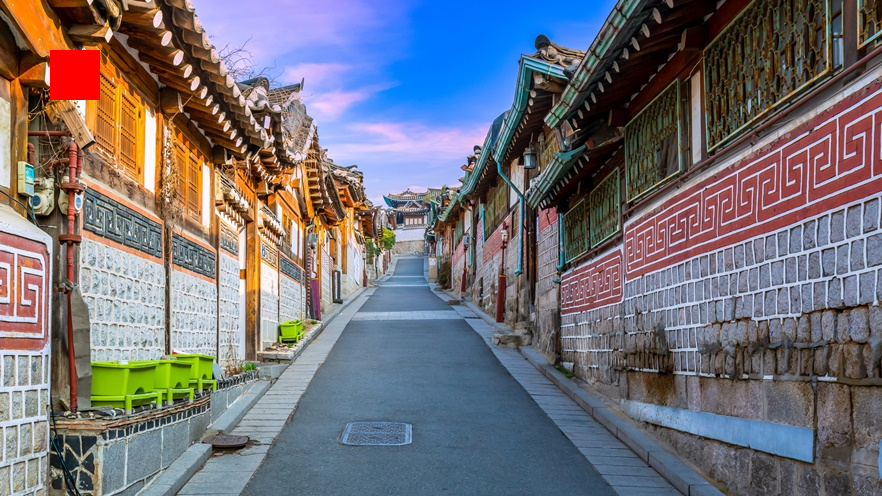

In [39]:
img[50:100, 50:100] = (0, 0, 255)
cv2_imshow(img)

# 이미지에 그리기
- 이미지에 선, 사각형, 원 그리기
- 이미지에 Text를 DIsplay

In [42]:
import cv2
from google.colab.patches import cv2_imshow

In [65]:
# 이미지 읽어오기
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [66]:
# 이미지 shape 확인
print(f'width: {img.shape[1]} pixels')
print(f'height: {img.shape[0]} pixels')
print(f'channels: {img.shape[2]} pixels')

width: 882 pixels
height: 496 pixels
channels: 3 pixels


## 원본 이미지

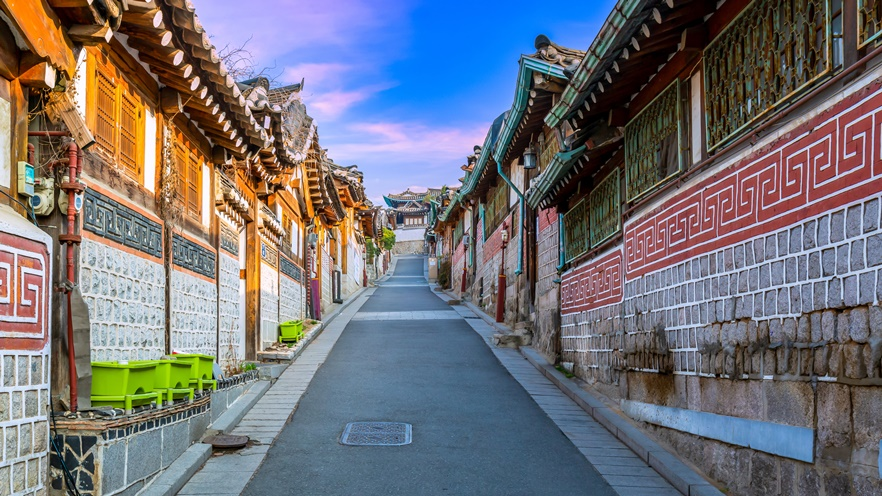

In [67]:
cv2_imshow(img)

## 범위 지정 변경

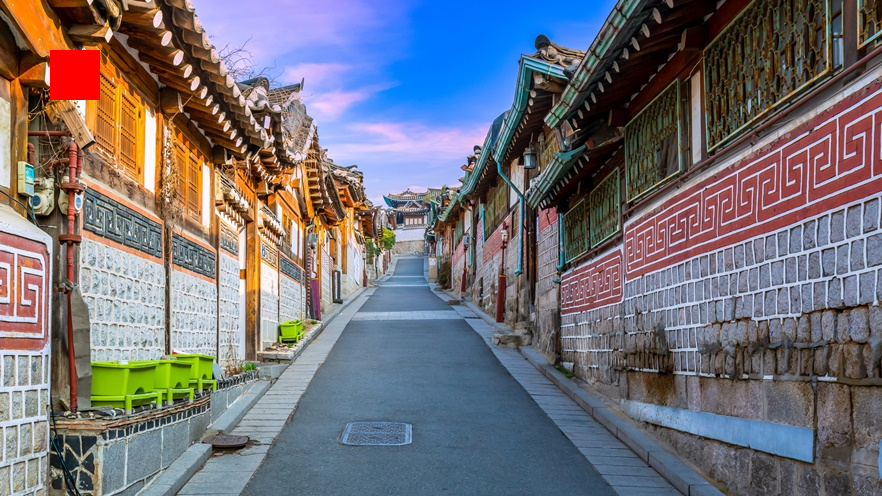

In [68]:
img[50:100, 50:100] = (0, 0, 255)
cv2_imshow(img)

## 선 그리기

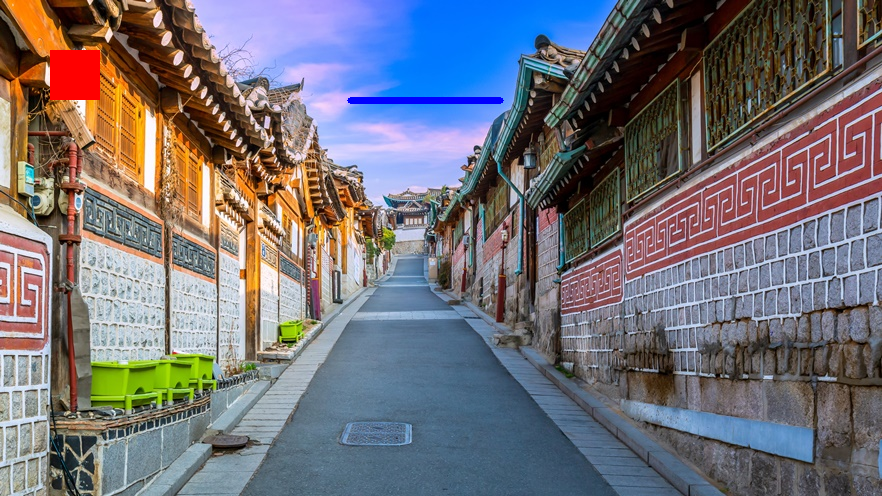

In [69]:
cv2.line(img, (350, 100), (500, 100), (255, 0, 0), 5)   # 시작점, 끝점, 선색상, 선굵기
cv2_imshow(img)

## 사각형 그리기

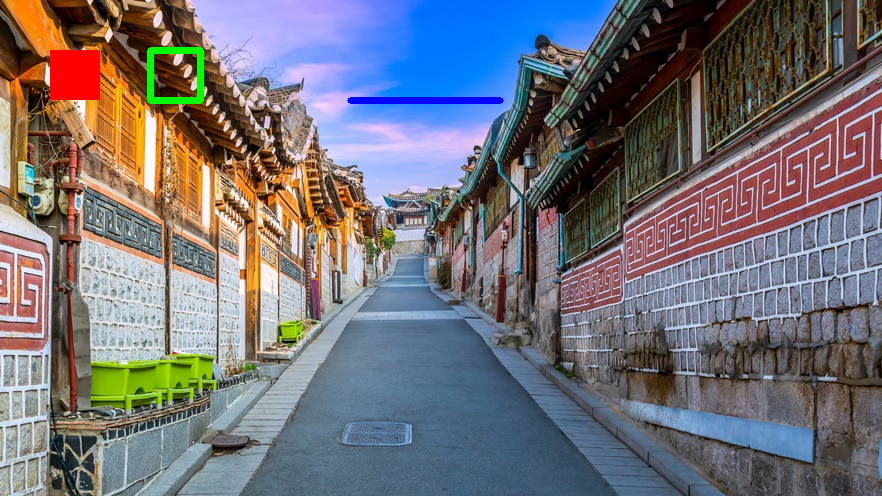

In [70]:
cv2.rectangle(img, (150, 50), (200, 100), (0, 255, 0), 5)   # 시작점, 끝점, 선색상, 선굵기
cv2_imshow(img)

## 원 그리기

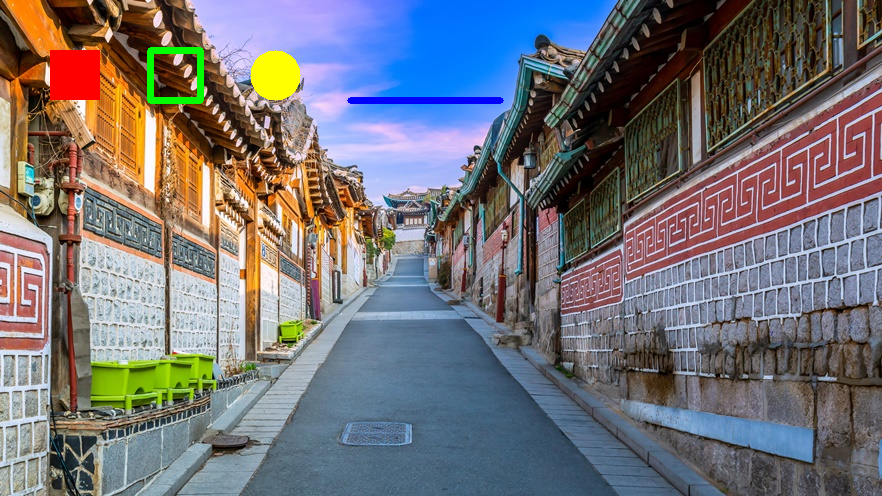

In [71]:
cv2.circle(img, (275, 75), 25, (0, 255, 255), -1)   # 중심점, 반지름, 색상, 선굵기
cv2_imshow(img)

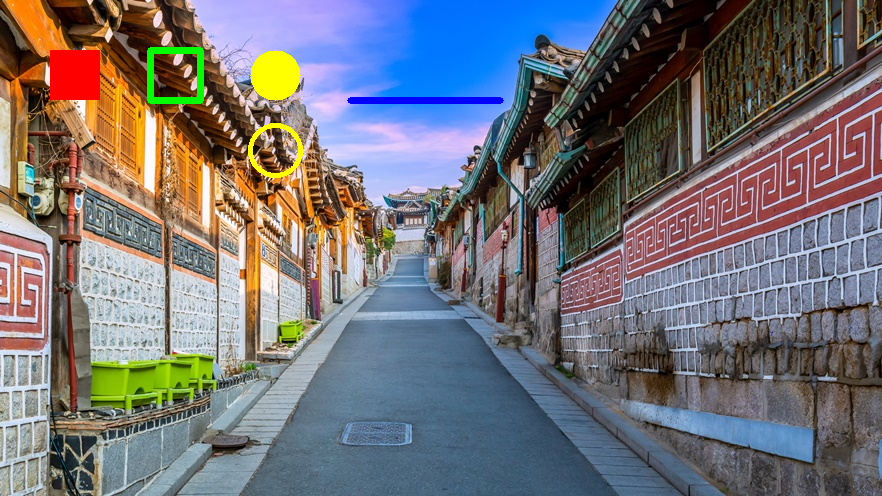

In [72]:
cv2.circle(img, (275, 150), 25, (0, 255, 255), 3)   # 중심점, 반지름, 색상, 선굵기
cv2_imshow(img)

## Text 작성

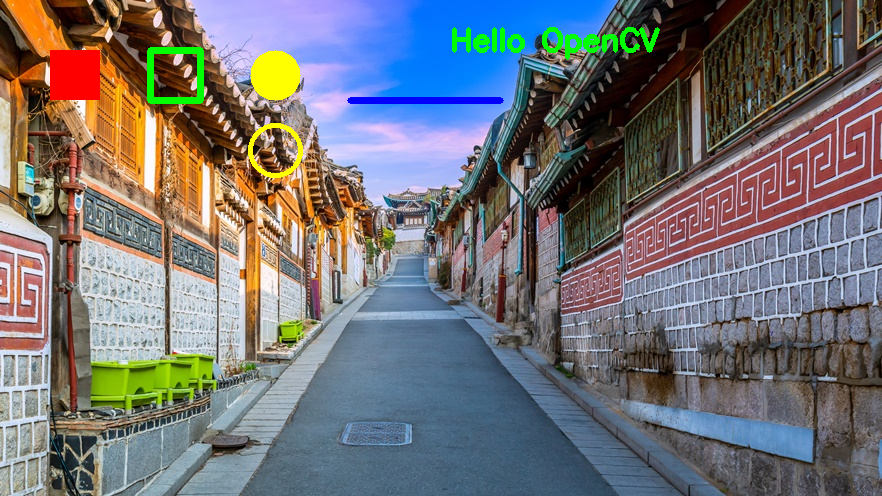

In [73]:
cv2.putText(img, 'Hello OpenCV', (450, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 4)
                                        # 입력글, 시작점, 폰트, 폰트크기, 폰트색상, 폰트 굵기

cv2_imshow(img)

### 한글 출력 - PIL 이용

In [74]:
import numpy as np
from PIL import ImageFont, ImageDraw, Image

### 한글 출력하고 폰트 투명도 적용

In [75]:
# BGR to RGBA 로 이미지 변환(원본 이미지)
base_img = Image.fromarray(img).convert('RGBA')

In [76]:
# 텍스트를 작성할 blank 이미지 생성
txt_img = Image.new('RGBA', base_img.size, (255, 255, 255, 0))

In [80]:
# blank 이미지에 한글 출력
fontpath = '/content/gdrive/MyDrive/CV/Basic Vision Skills/HYTBRB.TTF'                         # 폰트 경로
font = ImageFont.truetype(fontpath, 70)         # 폰트, 폰트크기 지정
draw = ImageDraw.Draw(txt_img)                  # blank 이미지에 텍스트를 넣기 위해 draw 인스턴스 생성

draw.text((200, 150), '컴퓨터비전', font=font, fill=(255, 255, 255, 0))     # alpha 완전투명
draw.text((200, 250), '컴퓨터비전', font=font, fill=(255, 255, 255, 128))   # alpha 반투명
draw.text((200, 350), '컴퓨터비전', font=font, fill=(255, 255, 255, 255))   # alpha 불투명

In [81]:
comp_img = Image.alpha_composite(base_img, txt_img) # base_img 와 txt_img를 합친다.
img = np.array(comp_img)

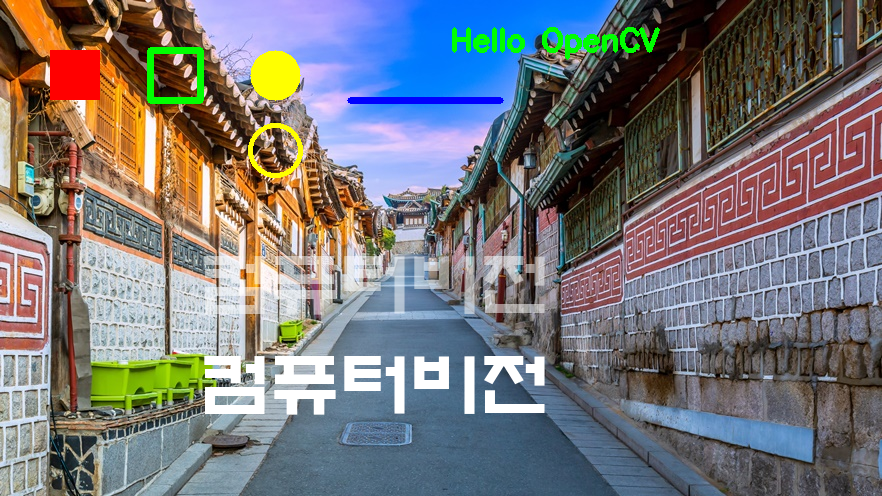

In [82]:
# 이미지 Display
cv2_imshow(img)

# 이미지 변경
- 이미지 이동
- 이미지 회전
- 이미지 크기 재조정
- 이미지 대칭

In [83]:
import cv2
from google.colab.patches import cv2_imshow

In [91]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [92]:
print(f'width: {img.shape[1]} pixels')
print(f'height: {img.shape[0]} pixels')
print(f'channels: {img.shape[2]}')

width: 882 pixels
height: 496 pixels
channels: 3


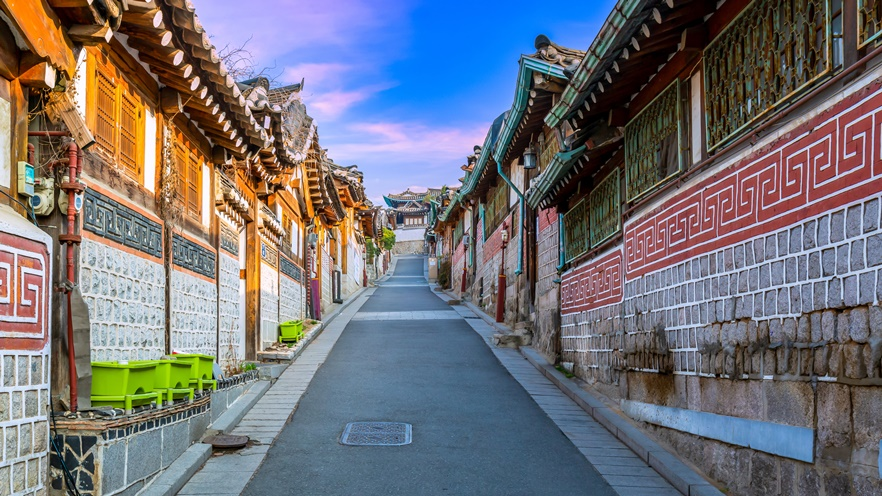

In [93]:
cv2_imshow(img)

## 이미지 이동

In [94]:
# 이미지를 이동 (Moved right: +, left -, down: +, up: -)
move = np.float32([[1, 0, 100], [0, 1, 100]])   # [1, 0, 100] -> [좌/우, 크기],
                                                # [0, 1, 100] -> [위/아래, 크기]

In [97]:
move.shape

(2, 3)

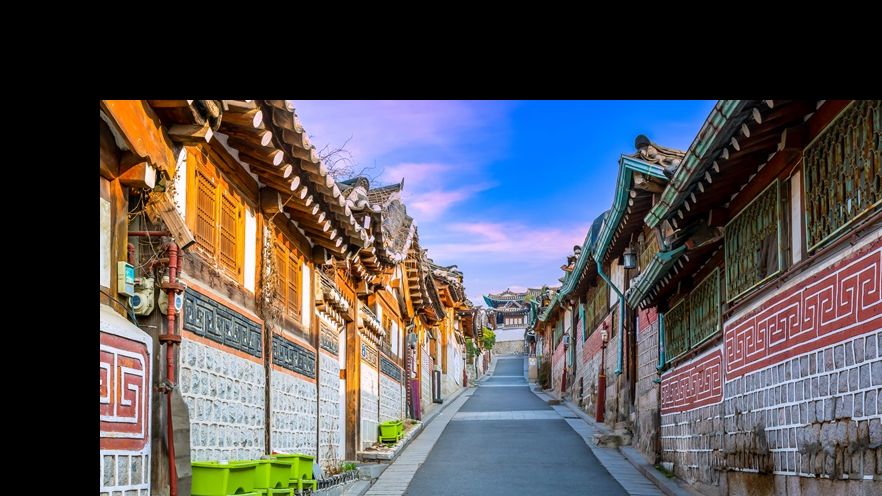

In [99]:
moved = cv2.warpAffine(img, move, (0, 0))
cv2_imshow(moved)

In [102]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [103]:
img.shape

(496, 882, 3)

### 이미지의 높이와 넓이 가져오기

In [105]:
(height, width) = img.shape[:2]

### 이미지 중심 구하기

In [106]:
center = (width // 2, height // 2)

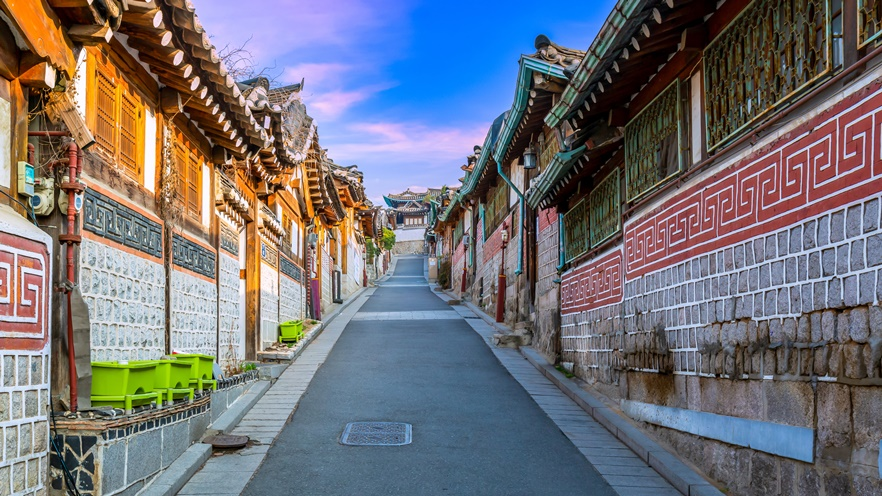

In [107]:
cv2_imshow(img)

## 이미지 회전

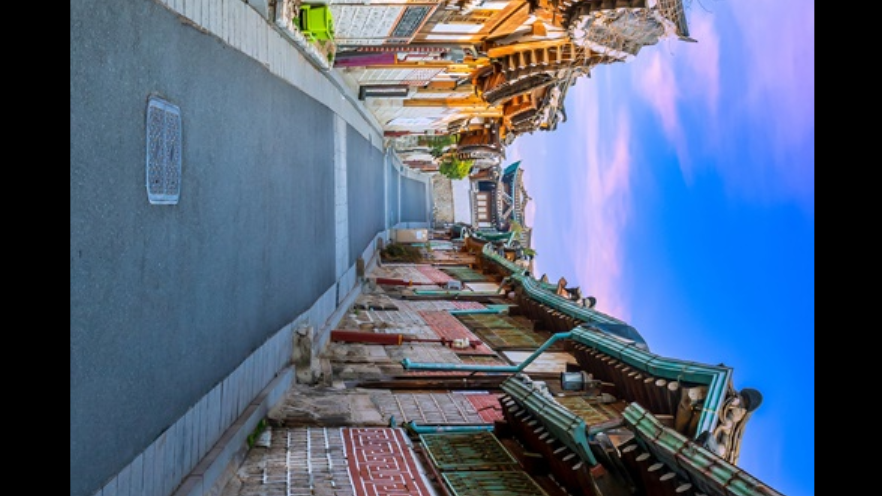

In [108]:
rotate = cv2.getRotationMatrix2D(center, -90, 1.5)  # 센터, 각도(+:반시계, -:시계), 스케일(확대)

rotated = cv2.warpAffine(img, rotate, (width, height))

# 이미지 Display
cv2_imshow(rotated)

## 이미지 크기 재조정

In [109]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

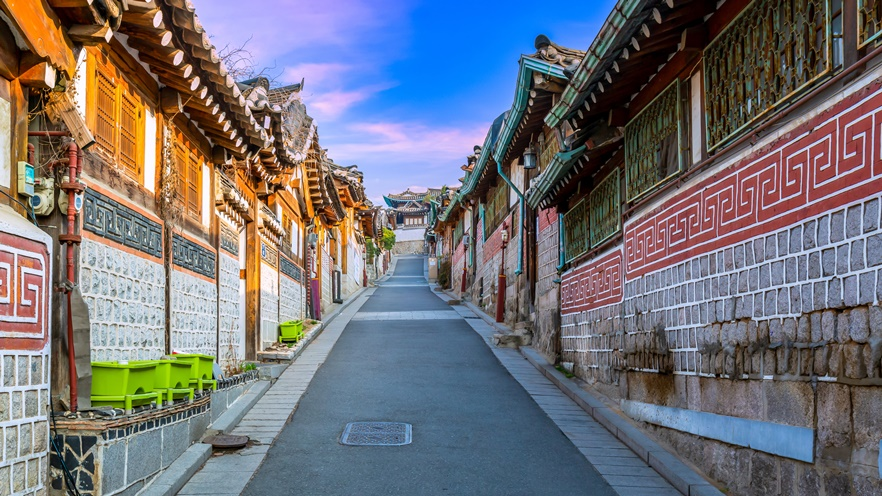

In [110]:
cv2_imshow(img)

In [111]:
ratio = 400.0 / width
dimension = (400, int(height * ratio))

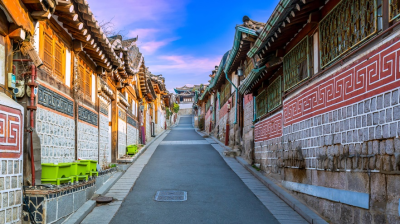

In [113]:
# 축소된 넓이, 높이의 사이즈로 이미지 재조정
resized = cv2.resize(img, dimension, interpolation = cv2.INTER_AREA)
cv2_imshow(resized)

## 이미지 좌우 반전

In [114]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [115]:
(height, width) = img.shape[:2]

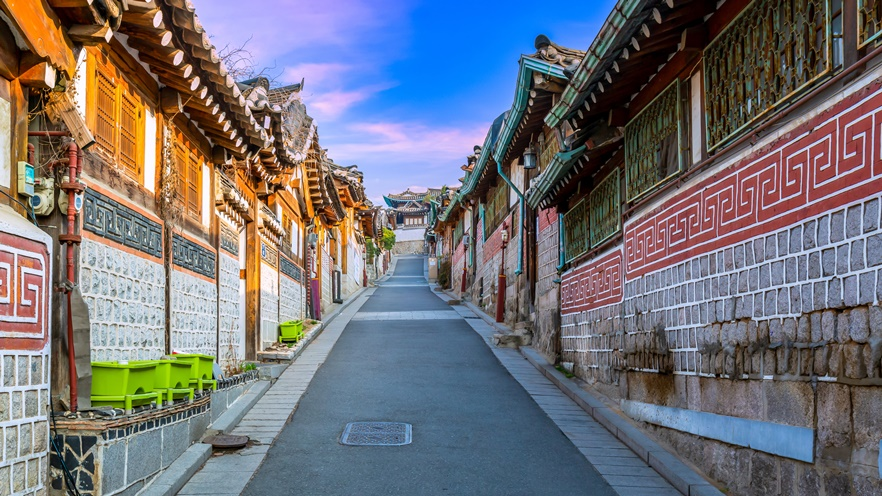

In [116]:
cv2_imshow(img)

In [117]:
# flip Horizontal 1, Veertical 0, both -1
flipped = cv2.flip(img, 1)

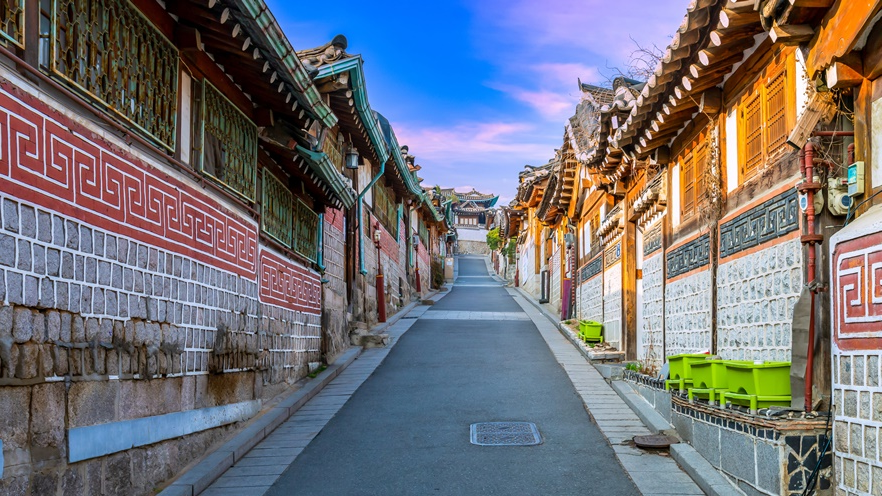

In [118]:
cv2_imshow(flipped)

# Masking
- 이미지 크기와 동일한 Mask를 생성
- 이미지에 Mask 적용

In [139]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [140]:
height, width = img.shape[:2]

In [141]:
center = (width // 2, height // 2)

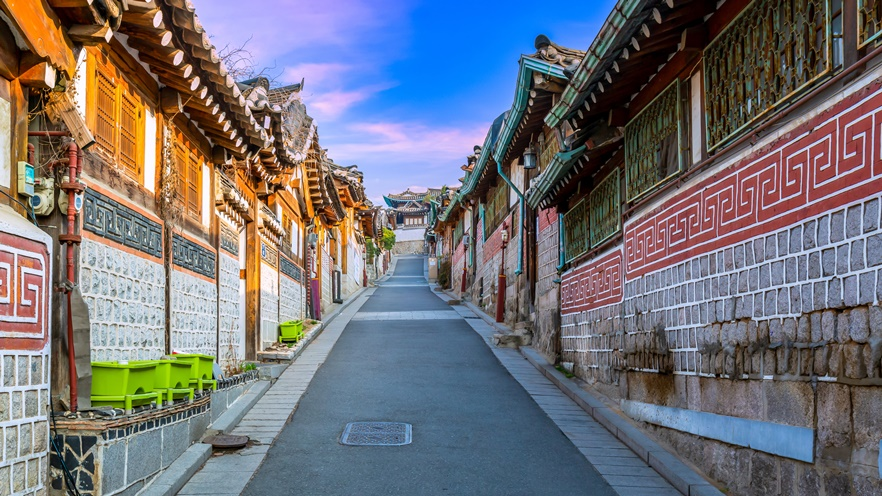

In [142]:
cv2_imshow(img)

## 이미지 크기와 같은 검정색 mask 생성

In [143]:
mask = np.zeros(img.shape[:2], dtype = 'uint8')

## mask에 filter 그리기

In [144]:
cv2.circle(mask, center, 300, (255, 255, 255), -1)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

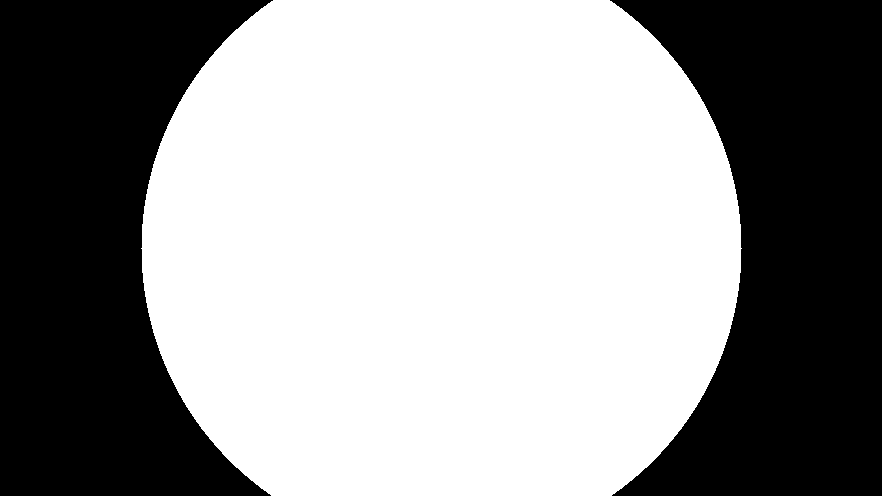

In [145]:
cv2_imshow(mask)

## mask 적용

In [146]:
masked = cv2.bitwise_and(img, img, mask = mask)

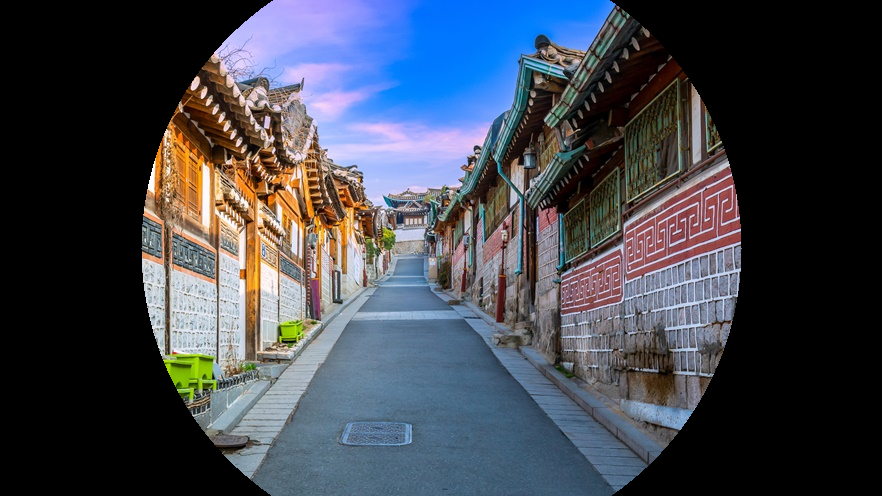

In [147]:
cv2_imshow(masked)

# Channel 조작
- 이미지의 채널 분할
- 분할된 이미지 채널 합치기
- 이미지 컬러 변환

In [148]:
img = cv2.imread('/content/gdrive/MyDrive/CV/Basic Vision Skills/bukchon.PNG')

In [149]:
height, width = img.shape[:2]

In [150]:
center = (width // 2, height // 2)

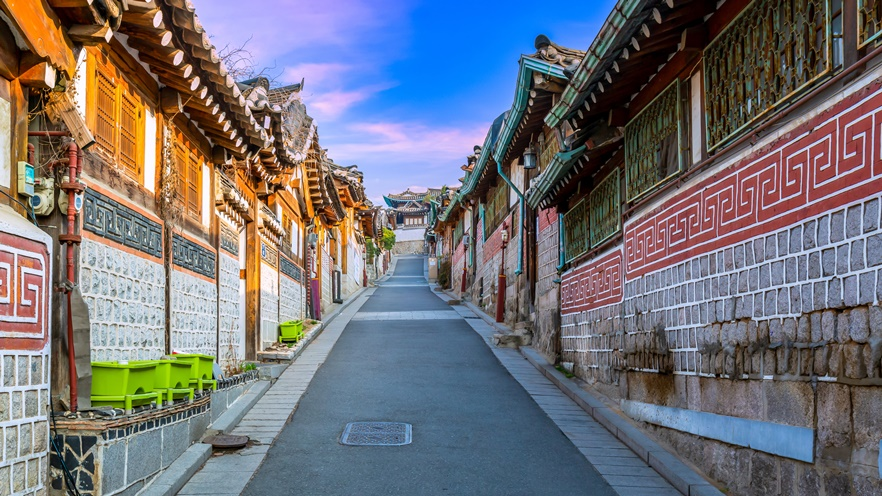

In [151]:
cv2_imshow(img)

## 이미지 채널 분할

In [153]:
(Blue, Green, Red) = cv2.split(img)

## 이미지 채널 합치기

In [154]:
zeros = np.zeros(img.shape[:2], dtype = 'uint8')

## 분할된 이미지 채널 DIsplay

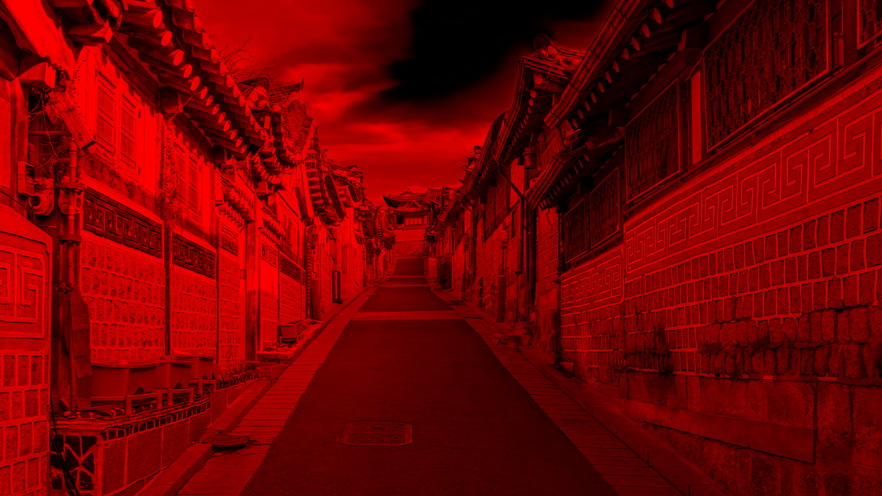

In [155]:
cv2_imshow(cv2.merge([zeros, zeros, Red]))

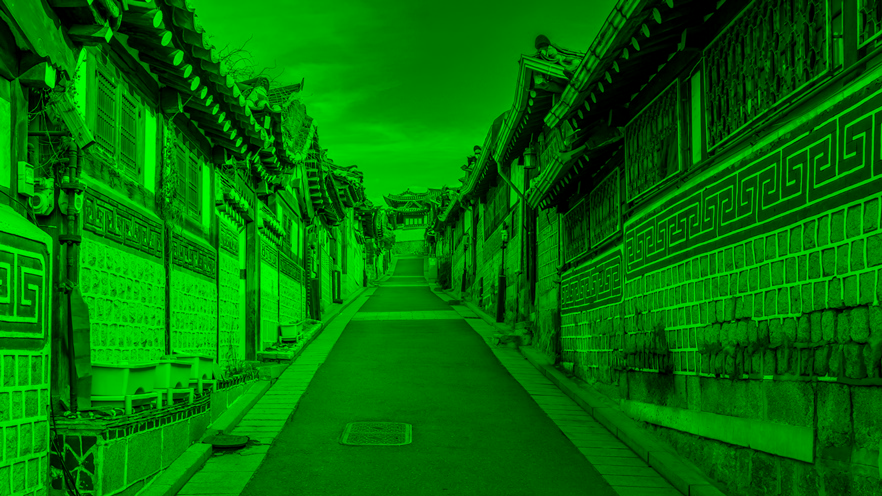

In [156]:
cv2_imshow(cv2.merge([zeros, Green, zeros]))

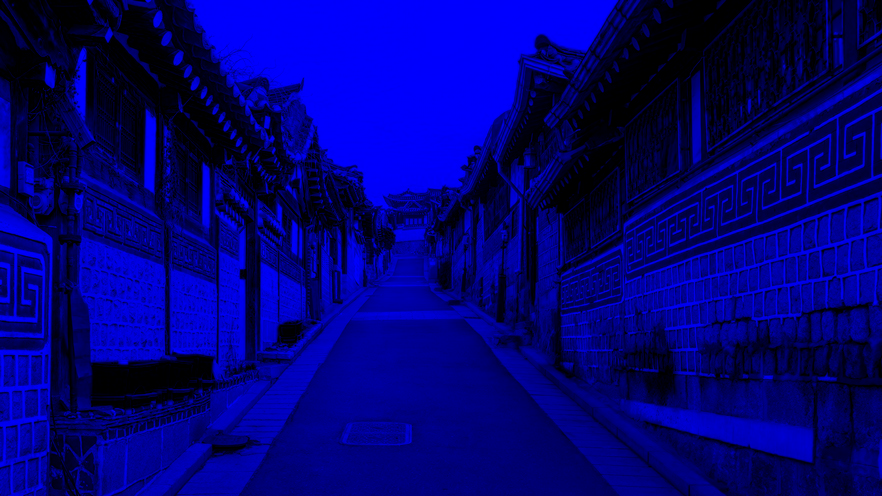

In [157]:
cv2_imshow(cv2.merge([Blue, zeros, zeros]))

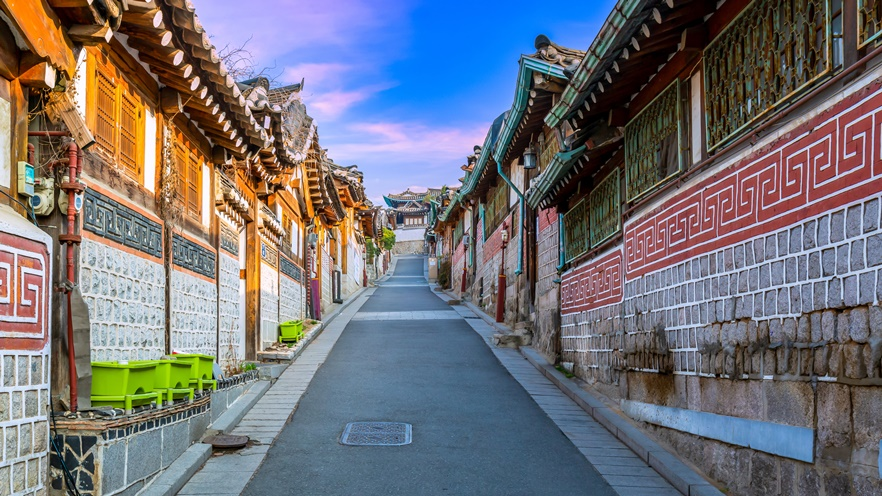

In [158]:
BGR = cv2.merge([Blue, Green, Red])
cv2_imshow(BGR)

## cvtColor 함수 이용 컬러 변환

### GRAY 변환

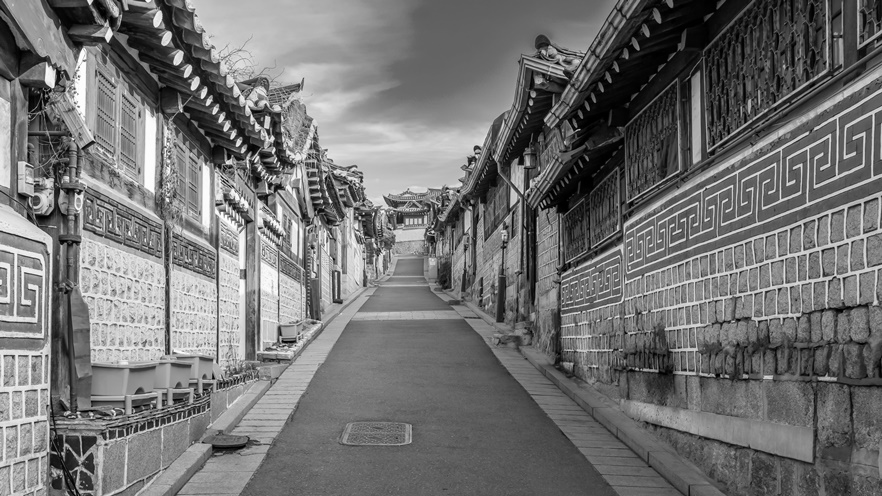

In [159]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

### HSV 변환

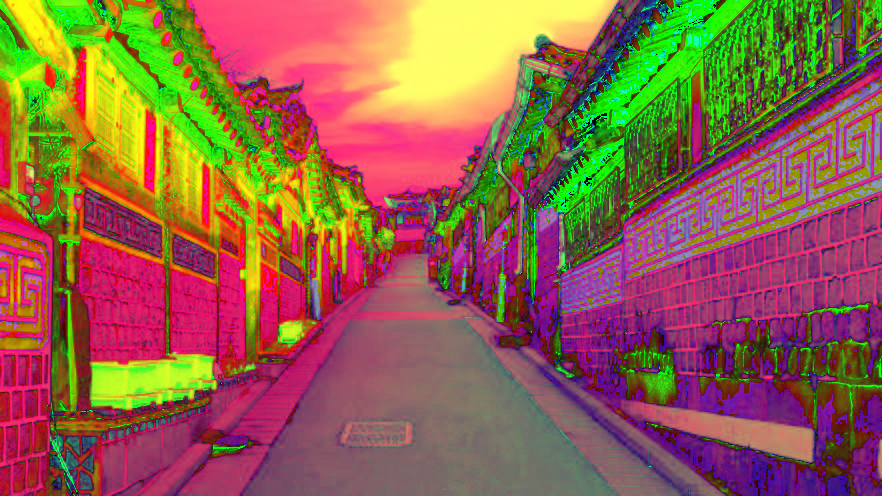

In [160]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
cv2_imshow(hsv)

### LAB 변환

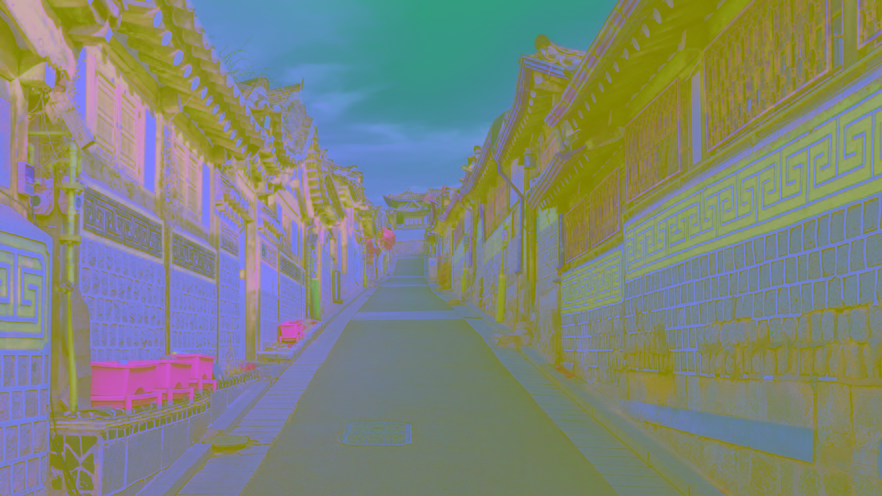

In [161]:
lab = cv2.cvtColor(img,cv2.COLOR_BGR2LAB)
cv2_imshow(lab)